In [1]:
import earthkit.data as ek
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import math

# Libraries for plotting and visualising data
%matplotlib inline
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from IPython.display import HTML
from matplotlib.colors import Normalize
from scipy.ndimage import label, center_of_mass
from statsmodels.tsa.stattools import pacf_yw

In [2]:
# Constants for the data set
GEMS_TOTAL_COLUMN_OZONE_SURFACE_COLUMN = "gtco3"
PARTICULATE_MATTER_D__25_UM_SURFACE_COLUMN = "pm2p5" # forest fires
SULPHATE_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN = "suaod550"
TOTAL_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN = "aod550"
TOTAL_COLUMN__ISOPRENE_SURFACE_COLUMN = "tc_c5h8"
TOTAL_COLUMN__PEROXYACETYL_NITRATE_SURFACE_COLUMN = "tc_pan"
TOTAL_COLUMN_CARBON_MONOXIDE_SURFACE_COLUMN = "tcco"
TOTAL_COLUMN_FORMALDEHYDE_SURFACE_COLUMN = "tchcho"
TOTAL_COLUMN_METHANE_SURFACE_COLUMN = "tc_ch4"
TOTAL_COLUMN_NITRIC_ACID_SURFACE_COLUMN = "tc_hno3"
TOTAL_COLUMN_NITROGEN_DIOXIDE_SURFACE_COLUMN = "tcno2"
TOTAL_COLUMN_NITROGEN_MONOXIDE_SURFACE_COLUMN = "tc_no"
TOTAL_COLUMN_PROPANE_SURFACE_COLUMN = "tc_c3h8"
TOTAL_COLUMN_SULPHUR_DIOXIDE_SURFACE_COLUMN = "tcso2"
TOTAL_COLUMN_WATER_VAPOUR_SURFACE_COLUMN = "tcwv"

ANIMATION_FRAMES = 4 # there are 31 days to animate in August
CIRCLE_THRESHOLD_PERCENTAGE = 80.0 # if a value exceeds 70% of the maximum value on a map consider it part of an island
N_SUB_PLOT_PER_ROW = 2
MASS_LIMIT_FOR_CIRCLE_SIZE = np.float32(1000.0)

In [8]:
import cdsapi
import os
cwd = os.getcwd()  # Get current working directory
WORK_DIR = cwd + "/../wa"

DEBUG_FILE = WORK_DIR + "/debug.txt"
# print(DEBUG_FILE)
def send_to_debug_file(**kwargs):
    with open(DEBUG_FILE, "w") as f:
        for key, value in kwargs.items():
            print(key, ":\n", value, "\n ########################################## \n", file=f)

In [9]:
data_file = WORK_DIR + "/SarkisianData.grib"
ds = xr.open_dataset(data_file, engine="cfgrib")
# display(ds)
# List all variables in the dataset
send_to_debug_file(ds_keys_full_list=list(ds.keys()), 
                   ds_keys=ds.keys(), 
                   ds_variables=ds.variables)

Ignoring index file '/Users/lingding/pythonVenv/climate-data/../wa/SarkisianData.grib.5b7b6.idx' incompatible with GRIB file
/Users/lingding/pythonVenv/lib/python3.13/site-packages/cfgrib/xarray_plugin.py:131: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  vars, attrs, coord_names = xr.conventions.decode_cf_variables(


In [10]:
# This code creates a colourmap similar to that used in CAMS products.

# Import the Matplotlib class 'ListedColormap' to generate a colormap object from a given list of colours
from matplotlib.colors import ListedColormap

# Array containing 15 colours ranging from white, grey, yellow and orange to red.
# Each row in the array contains three numbers for red, green and blue respectively.
# The numbers represent intensity, from 0 (black) to 256 (white).
matrix = np.array([[256, 256, 256],
                   [210, 214, 234],
                   [167, 174, 214],
                   [135, 145, 190],
                   [162, 167, 144],
                   [189, 188, 101],
                   [215, 209, 57],
                   [242, 230, 11],
                   [243, 197, 10],
                   [245, 164, 8],
                   [247, 131, 6],
                   [248, 98, 5],
                   [250, 65, 3],
                   [252, 32, 1],
                   [254, 0, 0]])
n = 17 # Multiplication number

cams = np.ones((253, 4)) # Initial empty colormap, to be filled by the colours in 'matrix'.

# This loop fills in the empty 'cams' colormap with each of the 15 colours in 'matrix'
# multiplied by 'n'. Each colour is divided by 256 to normalise from 0 (black) to 1 (white). 
for i in range(matrix.shape[0]):
    cams[(i*n):((i+1)*n),:] = np.array([matrix[i,0]/256, matrix[i,1]/256, matrix[i,2]/256, 1])

# The final colormap is given by 'camscmp', which uses the Matplotlib class 'ListedColormap(Colormap)'
# to generate a colormap object from the list of colours provided by 'cams'.
camscmp = ListedColormap(cams)

In [11]:
# extract each measured particulate matter or gas from the dataset and store as individual xarrays
ozone_data                                  = ds[GEMS_TOTAL_COLUMN_OZONE_SURFACE_COLUMN]
particulate_matter_25_um_data               = ds[PARTICULATE_MATTER_D__25_UM_SURFACE_COLUMN]
sulfate_aerosol_optical_depth_at_550nm_data = ds[SULPHATE_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN]
total_aerosol_optical_depth_at_550nm_data   = ds[TOTAL_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN]
isoprene_data                               = ds[TOTAL_COLUMN__ISOPRENE_SURFACE_COLUMN]
peroxyacetyl_nitrate_data                   = ds[TOTAL_COLUMN__PEROXYACETYL_NITRATE_SURFACE_COLUMN]
carbon_monoxide_data                        = ds[TOTAL_COLUMN_CARBON_MONOXIDE_SURFACE_COLUMN]
formaldehyde_data                           = ds[TOTAL_COLUMN_FORMALDEHYDE_SURFACE_COLUMN]
methane_data                                = ds[TOTAL_COLUMN_METHANE_SURFACE_COLUMN]
nitric_acid_data                            = ds[TOTAL_COLUMN_NITRIC_ACID_SURFACE_COLUMN]
nitrogen_dioxide_data                       = ds[TOTAL_COLUMN_NITROGEN_DIOXIDE_SURFACE_COLUMN]
nitrogen_monoxide_data                      = ds[TOTAL_COLUMN_NITROGEN_MONOXIDE_SURFACE_COLUMN]
propane_data                                = ds[TOTAL_COLUMN_PROPANE_SURFACE_COLUMN]
sulfur_dioxide_data                         = ds[TOTAL_COLUMN_SULPHUR_DIOXIDE_SURFACE_COLUMN]
water_vapor_data                            = ds[TOTAL_COLUMN_WATER_VAPOUR_SURFACE_COLUMN]

In [12]:
# get each gas to carbon monoxide ratio
ozone_to_carbon_monoxide_ratio                = ozone_data                                  / carbon_monoxide_data
particulate_matter_to_carbon_monoxide_ratio   = particulate_matter_25_um_data               / carbon_monoxide_data
sulfate_aerosol_to_carbon_monoxide_ratio      = sulfate_aerosol_optical_depth_at_550nm_data / carbon_monoxide_data
total_aerosol_to_carbon_monoxide_ratio        = total_aerosol_optical_depth_at_550nm_data   / carbon_monoxide_data
isoprene_to_carbon_monoxide_ratio             = isoprene_data                               / carbon_monoxide_data
peroxyacetyl_nitrate_to_carbon_monoxide_ratio = peroxyacetyl_nitrate_data                   / carbon_monoxide_data
formaldehyde_to_carbon_monoxide_ratio         = formaldehyde_data                           / carbon_monoxide_data
methane_to_carbon_monoxide_ratio              = methane_data                                / carbon_monoxide_data
nitric_acid_to_carbon_monoxide_ratio          = nitric_acid_data                            / carbon_monoxide_data
nitrogen_dioxide_to_carbon_monoxide_ratio     = nitrogen_dioxide_data                       / carbon_monoxide_data
nitrogen_monoxide_to_carbon_monoxide_ratio    = nitrogen_monoxide_data                      / carbon_monoxide_data
propane_to_carbon_monoxide_ratio              = propane_data                                / carbon_monoxide_data
sulfur_dioxide_to_carbon_monoxide_ratio       = sulfur_dioxide_data                         / carbon_monoxide_data
water_vapor_to_carbon_monoxide_ratio          = water_vapor_data                            / carbon_monoxide_data

In [13]:
side_by_side_data_array_list = [
    # ('ozone_to_carbon_monoxide_ratio', ozone_to_carbon_monoxide_ratio),
    ('particulate_matter_to_carbon_monoxide_ratio', particulate_matter_to_carbon_monoxide_ratio),
    ('sulfate_aerosol_to_carbon_monoxide_ratio', sulfate_aerosol_to_carbon_monoxide_ratio),
    # ('total_aerosol_to_carbon_monoxide_ratio', total_aerosol_to_carbon_monoxide_ratio),
    # ('isoprene_to_carbon_monoxide_ratio', isoprene_to_carbon_monoxide_ratio),
    # ('peroxyacetyl_nitrate_to_carbon_monoxide_ratio', peroxyacetyl_nitrate_to_carbon_monoxide_ratio),
    # ('formaldehyde_to_carbon_monoxide_ratio', formaldehyde_to_carbon_monoxide_ratio),
    ('methane_to_carbon_monoxide_ratio', methane_to_carbon_monoxide_ratio),
    # ('nitric_acid_to_carbon_monoxide_ratio', nitric_acid_to_carbon_monoxide_ratio),
    # ('nitrogen_dioxide_to_carbon_monoxide_ratio', nitrogen_dioxide_to_carbon_monoxide_ratio),
    # ('nitrogen_monoxide_to_carbon_monoxide_ratio', nitrogen_monoxide_to_carbon_monoxide_ratio),
    ('propane_to_carbon_monoxide_ratio', propane_to_carbon_monoxide_ratio),
    # ('sulfur_dioxide_to_carbon_monoxide_ratio', sulfur_dioxide_to_carbon_monoxide_ratio),
    # ('water_vapor_to_carbon_monoxide_ratio', water_vapor_to_carbon_monoxide_ratio),
]

In [14]:
def plot_single_day(data_array, projection, day_id, title):
    fig = plt.figure(figsize=(15, 10))

    # create the map using the cartopy PlateCarree projection
    ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
    
    # add lat/lon grid
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')

    # set figure title
    ax.set_title(title, fontsize=12) 

    # Plot the data
    norm = Normalize(vmin = data_array.min(), vmax = data_array.max())
    im = plt.pcolormesh(data_array.longitude, 
                        data_array.latitude, 
                        data_array[day_id,:,:],
                        cmap = camscmp, norm = norm)

    # Add coastlines
    ax.coastlines(color='black')

    # Specify the colourbar, including fraction of original axes to use for colorbar, 
    # and fraction of original axes between colorbar and new image axes
    cbar = plt.colorbar(im, fraction=0.025, pad=0.05) 

    # Define the colourbar label
    cbar.set_label(title)

    plt.show()

# Save the figure
# fig.savefig(f'{WORK_DIR}/test_sulphate_550nm_surface.png')

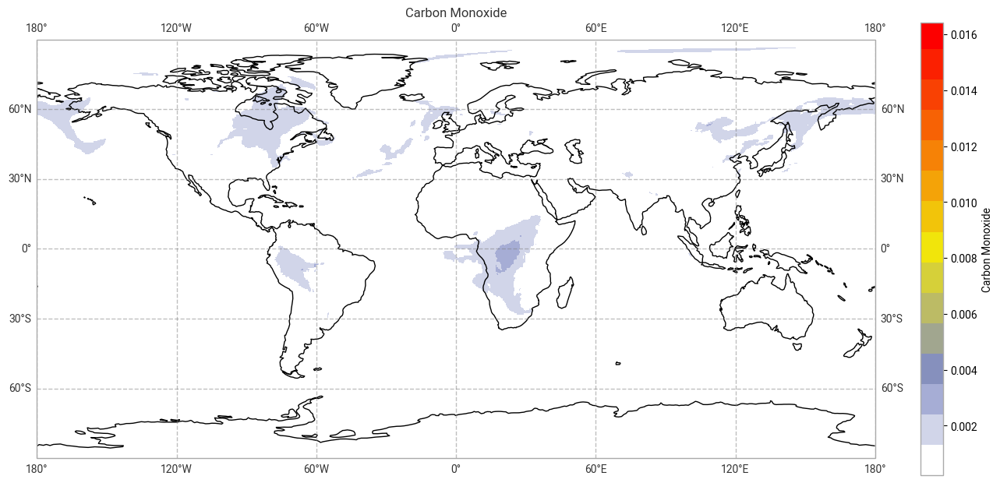

In [15]:
plot_single_day(carbon_monoxide_data, projection = ccrs.PlateCarree(), day_id = 0, title = "Carbon Monoxide") # test

In [16]:
def get_lat_and_long_of_centers_with_masses(three_dimension_data_array, day_id, threshold):
    # Dimensions -- time: 31; latitude: 451; longitude: 900
    values = three_dimension_data_array[day_id, :, :].values
    binary_mask = values > threshold

    # Label connected components
    labeled_array, num_hot_spots = label(binary_mask)

    # Compute centers of mass
    centers = center_of_mass(values, labeled_array, range(1, num_hot_spots + 1))

    # Compute mass of each island (sum of values in each labeled region)
    masses = [values[labeled_array == i].sum() for i in range(1, num_hot_spots + 1)]

    # Use lambda function to convert (y, x) to (longitude, latitude)
    convert_to_long_lat = lambda center: (
        three_dimension_data_array.longitude[math.floor(center[1])],
        three_dimension_data_array.latitude[math.floor(center[0])]
    )
    long_lat_array = list(map(convert_to_long_lat, centers))
    return long_lat_array, masses # both are lists

In [17]:
long_lat_array, masses = get_lat_and_long_of_centers_with_masses(
    sulfate_aerosol_optical_depth_at_550nm_data, # data array
    0, # day id
    1.0, # threshold to find heat island center
)

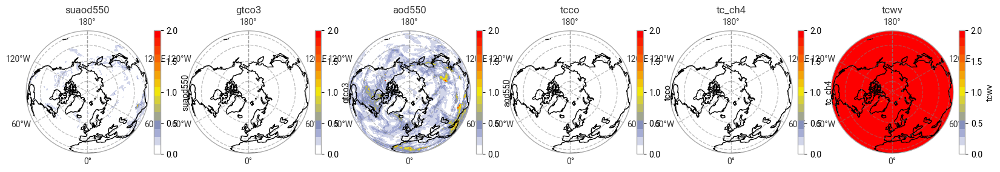

In [18]:
# all list, save as a starting point
all_side_by_side_plot_list = [SULPHATE_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN, 
                          GEMS_TOTAL_COLUMN_OZONE_SURFACE_COLUMN,
                          PARTICULATE_MATTER_D__25_UM_SURFACE_COLUMN,
                          TOTAL_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN,
                          TOTAL_COLUMN__ISOPRENE_SURFACE_COLUMN,
                          TOTAL_COLUMN__PEROXYACETYL_NITRATE_SURFACE_COLUMN,
                          TOTAL_COLUMN_CARBON_MONOXIDE_SURFACE_COLUMN,
                          TOTAL_COLUMN_FORMALDEHYDE_SURFACE_COLUMN,
                          TOTAL_COLUMN_METHANE_SURFACE_COLUMN,
                          TOTAL_COLUMN_NITRIC_ACID_SURFACE_COLUMN,
                          TOTAL_COLUMN_NITROGEN_DIOXIDE_SURFACE_COLUMN,
                          TOTAL_COLUMN_NITROGEN_MONOXIDE_SURFACE_COLUMN,
                          TOTAL_COLUMN_PROPANE_SURFACE_COLUMN,
                          TOTAL_COLUMN_SULPHUR_DIOXIDE_SURFACE_COLUMN,
                          TOTAL_COLUMN_WATER_VAPOUR_SURFACE_COLUMN,
                         ]
side_by_side_plot_list = [SULPHATE_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN,
                          GEMS_TOTAL_COLUMN_OZONE_SURFACE_COLUMN,
                          TOTAL_AEROSOL_OPTICAL_DEPTH_AT_550NM_SURFACE_COLUMN,
                          TOTAL_COLUMN_CARBON_MONOXIDE_SURFACE_COLUMN,
                          TOTAL_COLUMN_METHANE_SURFACE_COLUMN,
                          TOTAL_COLUMN_WATER_VAPOUR_SURFACE_COLUMN,
                         ]
fig, axs = plt.subplots(1, len(side_by_side_plot_list), figsize = (20, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
for i, column in enumerate(side_by_side_plot_list):
    da = ds[column]
    axs[i].gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--') # Add lat/lon grid
    axs[i].set_title(f'{column}', fontsize=12) # Set figure title
    im = axs[i].pcolormesh(da.longitude, da.latitude, da[0,:,:], # only print day 0
                            transform = ccrs.PlateCarree(), cmap=camscmp, vmin=0, vmax=2)
    axs[i].coastlines(color='black') # Add coastlines
    cbar = fig.colorbar(im, ax=axs[i], fraction=0.046, pad=0.04) # Specify the colourbar
    cbar.set_label(column) # Define the colourbar label

plt.show() # Display the figure

In [19]:
MASS_TO_CIRCLE_SCALE_RATIO = 1.0
TOP_K_CIRCLES_TO_DRAW = 5
NORMALIZE_UPPER_BOUND = 20.0
"""
def process_masses_to_radii_with_locations(long_lat_array, masses, scale_ratio, top_k, upper_bound):
    # Scale masses
    radii = np.array(masses) * scale_ratio
    
    # Find the K-th largest threshold (or 0 if fewer than K elements)
    if len(radii) >= top_k:
        threshold = np.partition(radii.flatten(), -top_k)[-top_k]  # Get K-th largest
    else:
        threshold = 0.0
    
    # Apply threshold (set values below threshold to 0)
    filtered_radii = np.where(radii >= threshold, radii, 0)
    if len(filtered_radii) == 0:
        return []
    
    # Normalize to range [0, upper_bound]
    min_val, max_val = np.min(filtered_radii), np.max(filtered_radii)
    if max_val > min_val:  # Avoid division by zero
        normalized_radii = upper_bound * (filtered_radii - min_val) / (max_val - min_val)
    else:
        normalized_radii = np.zeros_like(filtered_radii)  # If all values are the same
    
    # Keep only long_lat where radius > 0 (filtered)
    filtered_long_lat_radius = [
        (long_lat, radius) for long_lat, radius in zip(long_lat_array, normalized_radii) if radius > 0
    ]
    
    return filtered_long_lat_radius
"""

def process_masses_to_radii_with_locations(long_lat_array, masses, scale_ratio, top_k, upper_bound, outlier_percent=5):
    if len(masses) == 0:
        return []
        
    # Scale masses
    radii = np.array(masses) * scale_ratio

    # Compute percentile-based outlier thresholds
    lower_threshold = np.percentile(radii, outlier_percent)  # Bottom N% threshold
    upper_threshold = np.percentile(radii, 100 - outlier_percent)  # Top (100-N)% threshold

    # Filter out values outside the range
    # valid_mask = (radii >= lower_threshold) & (radii <= upper_threshold)
    valid_mask = (radii <= upper_threshold)
    filtered_radii = radii[valid_mask]
    filtered_long_lat = np.array(long_lat_array)[valid_mask]

    # If no valid values remain after outlier removal, return an empty list
    if len(filtered_radii) == 0:
        return []

    # Select the top K largest values from the filtered list
    if len(filtered_radii) > top_k:
        top_k_indices = np.argsort(filtered_radii)[-top_k:]  # Get indices of the top K largest
        filtered_radii = filtered_radii[top_k_indices]
        filtered_long_lat = filtered_long_lat[top_k_indices]

    # Normalize to range [0, upper_bound]
    min_val, max_val = np.min(filtered_radii), np.max(filtered_radii)
    if max_val > min_val:  # Avoid division by zero
        normalized_radii = upper_bound * (filtered_radii - min_val) / (max_val - min_val)
    else:
        normalized_radii = np.zeros_like(filtered_radii)  # If all values are the same

    # Prepare the final output with filtered locations and radii
    filtered_long_lat_radius = [
        (long_lat, radius) for long_lat, radius in zip(filtered_long_lat, normalized_radii) if radius > 0
    ]

    return filtered_long_lat_radius

    
def draw_circle_on_map(subplot, long_lat_array, masses):
    filtered_long_lat_radius = process_masses_to_radii_with_locations(
        long_lat_array, masses, MASS_TO_CIRCLE_SCALE_RATIO, TOP_K_CIRCLES_TO_DRAW, NORMALIZE_UPPER_BOUND)
    
    # Clear previous circles (important to avoid overlapping from previous frames)
    for patch in subplot.patches:
        patch.remove()
            
    # Draw circles around centers with radius proportional to mass
    for long_lat, radius in filtered_long_lat_radius:
        #print(f'radius={radius}, {type(radius)}')
        circle = plt.Circle(long_lat, radius, color='red', fill=False, linewidth=2)
        #print(f'circle={circle}')
        subplot.add_patch(circle)

In [20]:
CIRCLE_THRESHOLD_PERCENTAGE = 20.0 # if a value exceeds 70% of the maximum value on a map consider it part of an island
def draw_single_plot_frame(data_array, day_id, animate_title):
    array = data_array[day_id,:,:].values
    im.set_array(array.flatten())
    ax.set_title(f'{animate_title}, {str(data_array.time[day_id].values)[:-16]}', fontsize=12)

def draw_single_plot_frame_with_circles(data_array, day_id, animate_title):
    array = data_array[day_id,:,:].values
    im.set_array(array.flatten())
    ax.set_title(f'{animate_title}, {str(data_array.time[day_id].values)[:-16]}', fontsize=12)
    
    # set draw_circle_threshold to p70 of max
    draw_circle_threshold = data_array.min().values + (data_array.max().values - data_array.min().values) * (CIRCLE_THRESHOLD_PERCENTAGE / 100)
    
    long_lat_array, masses = get_lat_and_long_of_centers_with_masses(
        data_array,
        day_id,
        draw_circle_threshold, # threshold to find heat island center
    )
    #print(f'day_id={day_id}, min={data_array.min().values}, max={data_array.max().values}, th={draw_circle_threshold}, len_long_lat_array={len(long_lat_array)}')
    draw_circle_on_map(ax, long_lat_array, masses)

# Define the animate function to update the data for each frame
def draw_multi_plot_frame_with_circles(side_by_side_data_array_list, day_id):
    # Loop through the subplots and update each one
    for i, (title, data_array) in enumerate(side_by_side_data_array_list):
        # Update the data for each subplot (without creating a new pcolormesh)
        im_list[i].set_array(data_array[day_id, :, :].data)  # Update the data for the current day
        
        # Update title for each subplot
        sub_plot_col_id = i // N_SUB_PLOT_PER_ROW
        sub_plot_row_id = i % N_SUB_PLOT_PER_ROW
        da_min_val = data_array.min().values
        da_max_val = data_array.max().values
        axs[sub_plot_col_id][sub_plot_row_id].set_title(
            f'{title}, {str(data_array.time[day_id].values)[:-16]}, Min: {da_min_val:.2f}, Max: {da_max_val:.2f}', fontsize=12)

        # set draw_circle_threshold to p70 of max
        draw_circle_threshold = da_min_val + (da_max_val - da_min_val) * (CIRCLE_THRESHOLD_PERCENTAGE / 100)
        #print(f'day_id={day_id}, title={title}, da_min_val={da_min_val}, draw_circle_threshold={draw_circle_threshold}')
        long_lat_array, masses = get_lat_and_long_of_centers_with_masses(
            data_array, # data array
            day_id, # day id
            draw_circle_threshold, # threshold to find heat island center interms of percentage.
        )
        #print(f'day_id={day_id}, title={title}, size of long_lat = {len(long_lat_array)}')
        
        draw_circle_on_map(axs[sub_plot_col_id][sub_plot_row_id], long_lat_array, masses)
            
    return im_list  # Return the list of pcolormesh objects to update

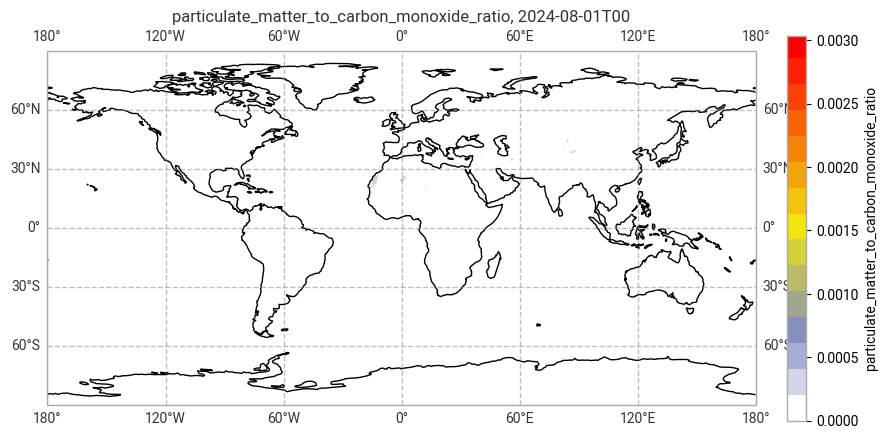

In [21]:
title = "particulate_matter_to_carbon_monoxide_ratio" # change
data_array = particulate_matter_to_carbon_monoxide_ratio # change
day_id = 0 # change
fig = plt.figure(figsize=(10, 5)) # Define the figure and specify size
ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree()) # Specify plot area & projection
ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--') # Add lat/lon grid
ax.set_title(f'{title}, {str(data_array.time[day_id].values)[:-16]}', fontsize=12) # Set figure title
ax.coastlines(color='black') # Add coastlines
norm = Normalize(vmin=data_array.min(), vmax=data_array.max())
im = plt.pcolormesh(data_array.longitude, 
                    data_array.latitude, 
                    data_array[day_id,:,:], 
                    cmap=camscmp, 
                    norm=norm) # Plot the data
cbar = plt.colorbar(im,fraction=0.046, pad=0.04) # Specify the colourbar
cbar.set_label(title) # Define the colourbar label

ani_particulate_matter_to_carbon_monoxide_ratio = animation.FuncAnimation(fig, lambda day_id: draw_single_plot_frame(
        data_array, day_id, title), ANIMATION_FRAMES, interval=1000)
HTML(ani_particulate_matter_to_carbon_monoxide_ratio.to_jshtml())

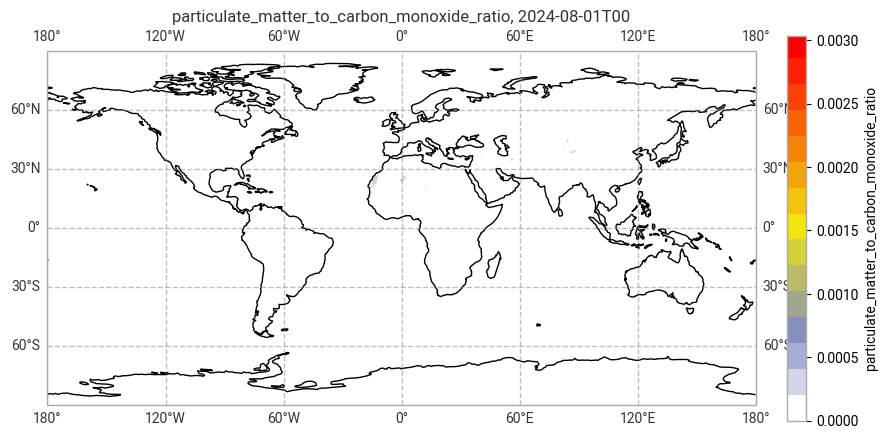

In [22]:
ANIMATION_FRAMES = 31

fig = plt.figure(figsize=(10, 5)) # Define the figure and specify size
ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree()) # Specify plot area & projection
ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--') # Add lat/lon grid
ax.set_title(f'{title}, {str(data_array.time[day_id].values)[:-16]}', fontsize=12) # Set figure title
ax.coastlines(color='black') # Add coastlines
norm = Normalize(vmin=data_array.min(), vmax=data_array.max())
im = plt.pcolormesh(data_array.longitude, 
                    data_array.latitude, 
                    data_array[day_id,:,:], 
                    cmap=camscmp, 
                    norm=norm) # Plot the data
cbar = plt.colorbar(im,fraction=0.046, pad=0.04) # Specify the colourbar
cbar.set_label(title) # Define the colourbar label

ani = animation.FuncAnimation(
    fig, lambda day_id: draw_single_plot_frame_with_circles(data_array, day_id, title), ANIMATION_FRAMES, interval=1000)
HTML(ani.to_jshtml())

In [23]:
# Define the animate function to update the data for each frame
def animate(day_id):
    # Loop through the subplots and update each one
    for i, column in enumerate(side_by_side_plot_list):
        da = ds[column]  # Get the data for each variable
        # print("got da for column ", column, " with day_id ", day_id, " time ", str(da.time[day_id].values))
        # Update the data for each subplot (without creating a new pcolormesh)
        im_list[i].set_array(da[day_id, :, :].data)  # Update the data for the current day
        
        # Update title for each subplot
        sub_plot_col_id = i // N_SUB_PLOT_PER_ROW
        sub_plot_row_id = i % N_SUB_PLOT_PER_ROW
        axs[sub_plot_col_id][sub_plot_row_id].set_title(
            f'{column}, {str(da.time[day_id].values)[:-16]}, Min: {da.min():.2f}, Max: {da.max():.2f}', fontsize=12)

    return im_list  # Return the list of pcolormesh objects to update

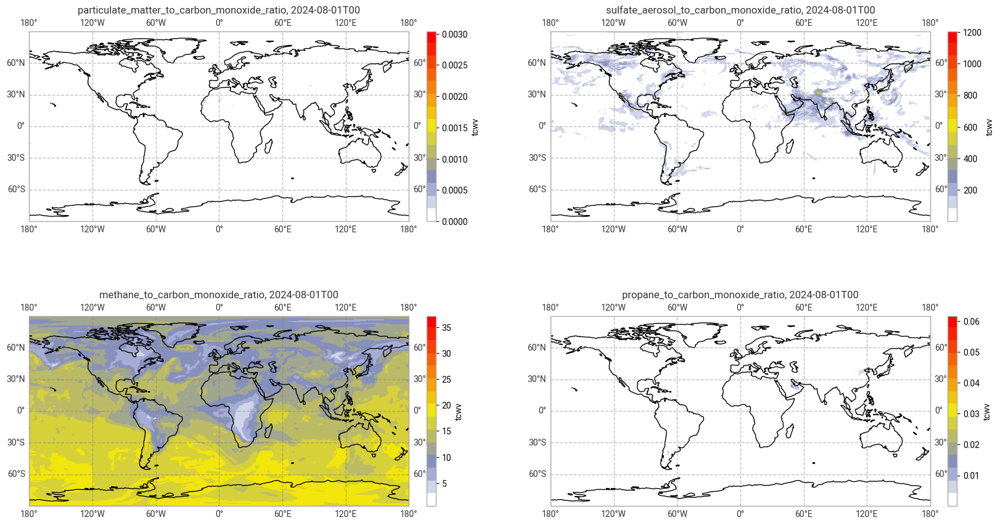

In [24]:
from matplotlib.colors import Normalize
import math
# Set up the figure and axes for the subplots
n_sub_plot_rows = math.ceil(len(side_by_side_data_array_list) / N_SUB_PLOT_PER_ROW)
# print(f'n_sub_plot_rows={n_sub_plot_rows}, list={side_by_side_data_array_list}, N_SUB_PLOT_PER_ROW={N_SUB_PLOT_PER_ROW}')
fig, axs = plt.subplots(n_sub_plot_rows, N_SUB_PLOT_PER_ROW, # N Rows and N Plot per row must greater than 1
                        figsize=(20, 10),
                        subplot_kw={'projection': ccrs.PlateCarree()})
fig.set_dpi(100)  # Set the pixel per inch to control image quality

# Initialize the plot for the first frame, including colorbars
im_list = []  # List to store pcolormesh objects

for i, (title, da) in enumerate(side_by_side_data_array_list):    
    sub_plot_col_id = i // N_SUB_PLOT_PER_ROW
    sub_plot_row_id = i % N_SUB_PLOT_PER_ROW
    
    # Create the initial plot for the first day (day 0) with normalization
    norm = Normalize(vmin=da.min(), vmax=da.max())  # Normalize based on each subplot's data range
    im = axs[sub_plot_col_id][sub_plot_row_id].pcolormesh(
        da.longitude, da.latitude, da[0, :, :],
        transform=ccrs.PlateCarree(), 
        norm=norm, # Apply normalization to each subplot
        # vmin=0, vmax=2, # pass a fix min and max value to plot the heat bar, not allowed when use norm
        cmap=camscmp)
    
    # Set initial figure title, will update in animate func
    axs[sub_plot_col_id][sub_plot_row_id].set_title(f'{title}, {str(da.time[0].values)[:-16]}', fontsize=12)
    axs[sub_plot_col_id][sub_plot_row_id].coastlines(color='black') # Add coastlines
    axs[sub_plot_col_id][sub_plot_row_id].gridlines(
        draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--') # Add lat/lon grid

    # Create colorbars only once, during the first frame (day 0)
    cbar = fig.colorbar(im, ax=axs[sub_plot_col_id][sub_plot_row_id], fraction=0.046, pad=0.04)
    cbar.set_label(column) # Define the colourbar label
    
    # Store the initial pcolormesh object for updating in the animation
    im_list.append(im)

fig.subplots_adjust(hspace=0.5)  # Increase vertical spacing

In [27]:
# Create the animation (one frame per day)
ANIMATION_TIME_INTERVAL_IN_MINI_SECONDS = 1000
ani = animation.FuncAnimation(fig, lambda day_id: draw_multi_plot_frame_with_circles(
        side_by_side_data_array_list, day_id), frames=ANIMATION_FRAMES, interval=ANIMATION_TIME_INTERVAL_IN_MINI_SECONDS)
# Show the animation
HTML(ani.to_jshtml())

In [32]:
PREFIX = 'ratio'
HTML(ani.to_html5_video())
#ani.save(f'{WORK_DIR}/{PREFIX}_animation.gif', dpi=100) # save to animated gif
#ani.save(f'{WORK_DIR}/{PREFIX}_animation.mp4', dpi=100) # save to mp4 video
# print(f'Files has been saved to {WORK_DIR}/{PREFIX}_animation.gif and {WORK_DIR}/{PREFIX}_animation.mp4')

In [29]:
# run patial auto correlation (PCAF) over particulate_matter_25_um_data
def run_pcaf_over_a_lag(data_array, shrink_factor_lat=5, shrink_factor_lon=5, lag = 1):
    # Shrink latitude and longitude dimensions by a factor, to reduce computation
    da_coarsened = data_array.coarsen(latitude=shrink_factor_lat, longitude=shrink_factor_lon, boundary='pad').mean()
    
    # Get dimensions
    days, lat_size, lon_size = da_coarsened.shape   

    # Create an empty array to store PACF values
    pacf_map = np.full((lat_size, lon_size), np.nan)  

    # Compute PACF for each grid point
    for lat_idx in range(lat_size):
        for lon_idx in range(lon_size):
            time_series = da_coarsened[:, lat_idx, lon_idx].values  # Extract time series at grid point
        
            # Compute PACF (only if the series has no NaNs)
            if not np.any(np.isnan(time_series)):
                pacf_values = pacf_yw(time_series, nlags=lag, method='adjusted')  
                pacf_map[lat_idx, lon_idx] = pacf_values[lag]  # Store the PACF value for the selected lag
        # Convert the numpy array into an xarray DataArray

    pacf_xarray = xr.DataArray(
        pacf_map, 
        coords={
            'latitude': da_coarsened.coords['latitude'],
            'longitude': da_coarsened.coords['longitude']  # Use the same coordinates as the input data
        },
        dims=['latitude', 'longitude']
    )
    
    return pacf_xarray

In [30]:
title = "pm2.5 PACF correlation" # change
data_to_be_processed = particulate_matter_25_um_data # change
lag = 2 # days of lag
shrink_factor_lat = 2 # original 451 x 900 of latitude and longitude is too large to compute correlation
shrink_factor_long = 2
draw_north_pole_view = True

# run patial auto correlation (PCAF) over particulate_matter_25_um_data
pacf_map = run_pcaf_over_a_lag(data_to_be_processed, shrink_factor_lat, shrink_factor_long, lag)

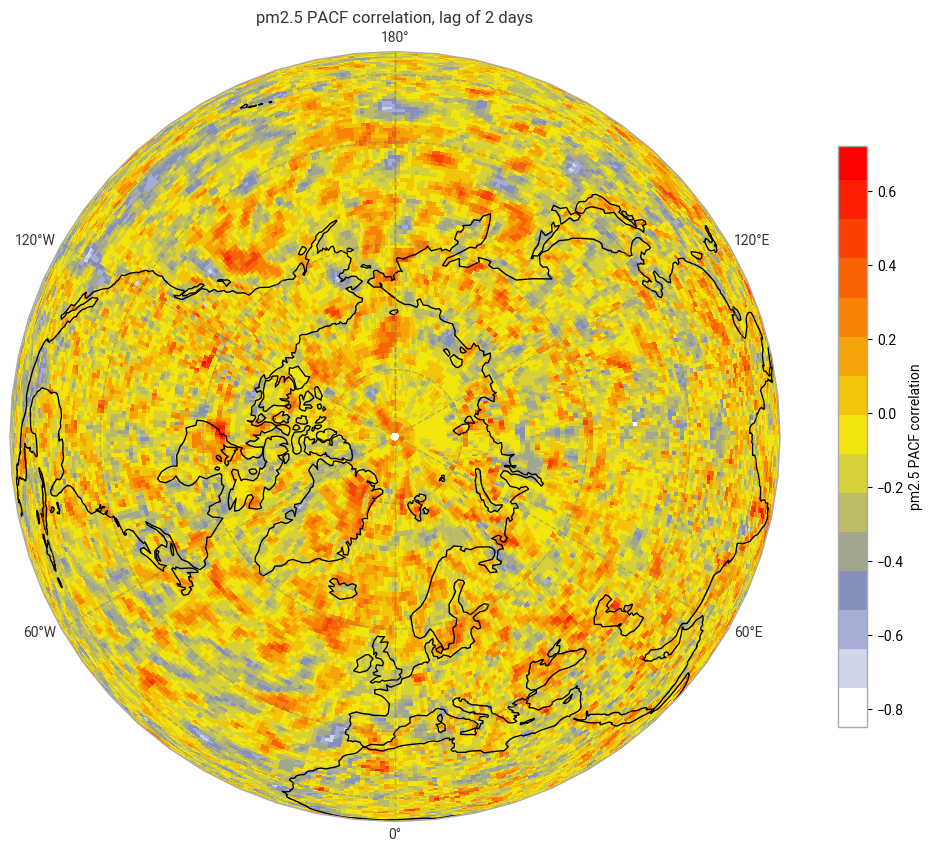

In [31]:
# Plot the PACF values as a heatmap
fig = plt.figure(figsize=(15, 10)) # Define the figure and specify size
if draw_north_pole_view:
    ax = plt.subplot(1,1,1, projection=ccrs.Orthographic(central_latitude=90)) # Polar area
    transform_config = ccrs.PlateCarree()
else:
    ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree()) # Specify plot area & projection
    transform_config = None
    
ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--') # Add lat/lon grid
ax.set_title(f'{title}, lag of {lag} days', fontsize=12) # Set figure title
ax.coastlines(color='black') # Add coastlines
norm = Normalize(vmin=pacf_map.min(), vmax=pacf_map.max())
im = plt.pcolormesh(pacf_map.longitude, 
                    pacf_map.latitude, 
                    pacf_map.values,
                    transform = transform_config,
                    cmap=camscmp,
                    shading="auto",
                    norm=norm) # Plot the data
cbar = plt.colorbar(im,fraction=0.025, pad=0.05) # Specify the colourbar
cbar.set_label(title) # Define the colourbar label
plt.show()